## 기본 데이터  작업
- 현재 화폐가치 변환
- 파생 데이터 추가: 평수, 평당 가격, 연식기간(거래년도 - 건축일자), 지역별 평당 가격 비율 * 5
- 가격 비율1: 경기도 월별 평당 가격 / 양평 매매 평당 가격
- 가격 비율2: 서울 월별 평당 가격 / 양평 매매 평당 가격
- 가격 비율3: 강원도 월별 평당 가격 / 양평 매매 평당 가격
- 가격 비율4: 제주도 월별 평당 가격 / 양평 매매 평당 가격 
- 가격 비율5: 전국 월별 평당 가격 / 양평 매매 평당 가격

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cx_Oracle

In [2]:
def get_data_from_db(query):
    conn = cx_Oracle.connect('hoseo', 'hoseo', 'localhost:1521/xe')
    df = pd.read_sql(query, conn)
    conn.close()
    return df

In [3]:
# 평수, 평당 가격, 연식기간 추가
query = f"""
    SELECT region, region_sub, apt_name,
           apt_size, apt_floor, contract_date,
           contract_price, completion_year,
           (to_number(to_char(contract_date, 'YYYY')) - completion_year) period_completed,
           round((apt_size / 3.3), 2) pyung,
           round(contract_price / (apt_size / 3.3)) price_per_pyung
    FROM apt_deal_price
    WHERE region = '경기도' AND
          region_sub LIKE '%양평%'
    """

In [4]:
def make_csv_from_db(query, save_path):
    dataD = get_data_from_db(query)
    lower_col = dataD.columns.values.tolist()
    dataD.columns = [ l.lower() for l in lower_col ]
    dataD.to_csv(save_path, index=False, encoding='utf-8-sig')


In [5]:
# make_csv_from_db(query, 'sub-data-files/yangpyung_region.csv')

In [6]:
basicD = pd.read_csv('sub-data-files/yangpyung_region.csv')
basicD.info()
basicD.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3576 entries, 0 to 3575
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   region            3576 non-null   object 
 1   region_sub        3576 non-null   object 
 2   apt_name          3576 non-null   object 
 3   apt_size          3576 non-null   float64
 4   apt_floor         3576 non-null   int64  
 5   contract_date     3576 non-null   object 
 6   contract_price    3576 non-null   int64  
 7   completion_year   3576 non-null   int64  
 8   period_completed  3576 non-null   int64  
 9   pyung             3576 non-null   float64
 10  price_per_pyung   3576 non-null   int64  
dtypes: float64(2), int64(5), object(4)
memory usage: 307.4+ KB


,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,price_per_pyung
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,9785714
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,9642857
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,8229176
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,5164214
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,4257775


In [7]:
# 화폐가치 계산을 위한 구분값 추가
basicD['contract_year'] = basicD['contract_date'].str.slice(stop=4)
# basicD['contract_year']

# merge를 위한 키값 추가
basicD['contract_date_key'] = basicD['contract_date'].str.replace('-', '/').str.slice(stop=-3)
# basicD['contract_date_key']

In [8]:
# http://kostat.go.kr/incomeNcpi/cpi/cpi_ep/2/index.action?bmode=pay

# 소비자물가지수 변동에 의한 화폐가치 계산
value_factor = {
    '2012': 1.083, '2013': 1.069, '2014': 1.056, '2015': 1.049,
    '2016': 1.039, '2017': 1.019, '2018': 1.004, '2019': 1.000, '2020': 1.000 }


In [9]:
def convert_present_value(D):
    vf = value_factor[D['contract_year']]
    D['price_per_pyung_present'] = round(D['price_per_pyung'] * vf)
    return D


In [10]:
basicD = basicD.apply(convert_present_value, axis=1)
basicD.info()
basicD.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3576 entries, 0 to 3575
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   region                   3576 non-null   object 
 1   region_sub               3576 non-null   object 
 2   apt_name                 3576 non-null   object 
 3   apt_size                 3576 non-null   float64
 4   apt_floor                3576 non-null   int64  
 5   contract_date            3576 non-null   object 
 6   contract_price           3576 non-null   int64  
 7   completion_year          3576 non-null   int64  
 8   period_completed         3576 non-null   int64  
 9   pyung                    3576 non-null   float64
 10  price_per_pyung          3576 non-null   int64  
 11  contract_year            3576 non-null   object 
 12  contract_date_key        3576 non-null   object 
 13  price_per_pyung_present  3576 non-null   int64  
dtypes: float64(2), int64(6),

,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,price_per_pyung,contract_year,contract_date_key,price_per_pyung_present
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,9785714,2012,2012/08,10597928
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,9642857,2012,2012/08,10443214
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,8229176,2012,2012/08,8912198
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,5164214,2012,2012/08,5592844
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,4257775,2012,2012/08,4611170


In [11]:
# 기본 데이터 탐색으로 뽑아놓은 월별 평당 가격 데이터
readD = pd.read_csv('sub-data-files/region_avg_price_per_pyung_month.csv')
readD

,region,ym201208,ym201209,ym201210,ym201211,ym201212,ym201301,ym201302,ym201303,ym201304,...,ym201910,ym201911,ym201912,ym202001,ym202002,ym202003,ym202004,ym202005,ym202006,ym202007
0,강원도,5119250,5095286,4998207,4991621,4938578,5095420,5105624,4545184,5075322,...,6506124,6513893,6946799,6742633,6690813,6620664,6526321,6865083,7441503,7147556
1,경기도,9775160,10125170,10421214,10398610,10409208,10238318,10351601,10466027,10549645,...,16601336,17185471,16412237,15685046,15325904,14077135,13613289,14859319,17084424,17185610
2,경상남도,6881622,7086819,7188409,7023321,6989572,7291461,7225936,7359711,7608994,...,9037953,9391425,8759668,9078625,8667616,8114775,8141990,8940838,10604776,9793935
3,경상북도,5103845,5202156,5234563,5226411,4992737,5261965,5331156,5312663,5281205,...,6669935,6807977,6744104,6796241,6780109,6594742,6362860,7034261,7428216,6831766
4,광주광역시,5988665,6194381,6151116,6209057,6204378,6202909,6242817,6222630,6185710,...,9712906,9993954,10268687,10447595,10017985,9695587,9420916,9720282,10538647,10454689
5,대구광역시,7482722,7672230,7678458,7692953,7567545,7787475,7709018,7733504,7950864,...,12452985,13108171,12951174,12601337,12400786,10390903,11702270,12059514,13253109,13729267
6,대전광역시,7555288,7867073,8061890,8061391,8194041,7936135,8274393,7905356,7905723,...,11066117,11498263,11540035,11248709,11277791,11161933,10413735,11656896,13240731,11865328
7,부산광역시,8729204,8609064,9264729,9021650,8904135,8480117,8461140,8468690,8746945,...,13365527,15005222,13940123,13291662,13317158,12725565,12591612,13319133,15425615,14546673
8,서울특별시,18052436,18772325,18865725,19119211,19369297,19406076,19472246,18847519,18981343,...,35145037,35061357,33287420,29839420,30966240,30166635,31400136,34549971,36845043,35727948
9,세종특별자치시,5695279,6361043,6423996,6347730,6170538,5688832,6189864,5881194,5924617,...,15143114,16505586,17271520,15885289,17320983,15240895,14011986,15773361,18738289,19816000


In [12]:
statD = readD.set_index('region')
statD = statD.T
statD.index = [ f'{s[2:6]}/{s[-2:]}' for s in statD.index ]
statD['전국'] = statD.mean(axis=1).astype('int64')
statD = statD[['경기도', '서울특별시', '강원도', '제주특별자치도', '전국']]
statD = statD.reset_index()
statD.columns = ['date_yyyymm', 'gg', 'seo', 'gw', 'jj', 'all']
statD.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96 entries, 0 to 95
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date_yyyymm  96 non-null     object
 1   gg           96 non-null     int64 
 2   seo          96 non-null     int64 
 3   gw           96 non-null     int64 
 4   jj           96 non-null     int64 
 5   all          96 non-null     int64 
dtypes: int64(5), object(1)
memory usage: 4.6+ KB


In [13]:
testD = basicD.merge(statD, how='left', left_on='contract_date_key', right_on='date_yyyymm')
testD.info()
testD.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3576 entries, 0 to 3575
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   region                   3576 non-null   object 
 1   region_sub               3576 non-null   object 
 2   apt_name                 3576 non-null   object 
 3   apt_size                 3576 non-null   float64
 4   apt_floor                3576 non-null   int64  
 5   contract_date            3576 non-null   object 
 6   contract_price           3576 non-null   int64  
 7   completion_year          3576 non-null   int64  
 8   period_completed         3576 non-null   int64  
 9   pyung                    3576 non-null   float64
 10  price_per_pyung          3576 non-null   int64  
 11  contract_year            3576 non-null   object 
 12  contract_date_key        3576 non-null   object 
 13  price_per_pyung_present  3576 non-null   int64  
 14  date_yyyymm             

,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,price_per_pyung,contract_year,contract_date_key,price_per_pyung_present,date_yyyymm,gg,seo,gw,jj,all
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,9785714,2012,2012/08,10597928,2012/08,9775160,18052436,5119250,6280176,7352279
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,9642857,2012,2012/08,10443214,2012/08,9775160,18052436,5119250,6280176,7352279
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,8229176,2012,2012/08,8912198,2012/08,9775160,18052436,5119250,6280176,7352279
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,5164214,2012,2012/08,5592844,2012/08,9775160,18052436,5119250,6280176,7352279
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,4257775,2012,2012/08,4611170,2012/08,9775160,18052436,5119250,6280176,7352279


In [14]:
def calc_price_ratio(D):
    D['gg_ratio'] = round(D['gg'] / D['price_per_pyung'], 2)
    D['seo_ratio'] = round(D['seo'] / D['price_per_pyung'], 2)
    D['gw_ratio'] = round(D['gw'] / D['price_per_pyung'], 2)
    D['jj_ratio'] = round(D['jj'] / D['price_per_pyung'], 2)
    D['all_ratio'] = round(D['all'] / D['price_per_pyung'], 2)
    return D

In [15]:
testD = testD.apply(calc_price_ratio, axis=1)
# testD.to_csv('sub-data-files/yangpyung_region_ex2.csv', index=False, encoding='utf-8-sig')
testD.info()
testD.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3576 entries, 0 to 3575
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   region                   3576 non-null   object 
 1   region_sub               3576 non-null   object 
 2   apt_name                 3576 non-null   object 
 3   apt_size                 3576 non-null   float64
 4   apt_floor                3576 non-null   int64  
 5   contract_date            3576 non-null   object 
 6   contract_price           3576 non-null   int64  
 7   completion_year          3576 non-null   int64  
 8   period_completed         3576 non-null   int64  
 9   pyung                    3576 non-null   float64
 10  price_per_pyung          3576 non-null   int64  
 11  contract_year            3576 non-null   object 
 12  contract_date_key        3576 non-null   object 
 13  price_per_pyung_present  3576 non-null   int64  
 14  date_yyyymm             

,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,...,gg,seo,gw,jj,all,gg_ratio,seo_ratio,gw_ratio,jj_ratio,all_ratio
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,...,9775160,18052436,5119250,6280176,7352279,1.00,1.84,0.52,0.64,0.75
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,...,9775160,18052436,5119250,6280176,7352279,1.01,1.87,0.53,0.65,0.76
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,...,9775160,18052436,5119250,6280176,7352279,1.19,2.19,0.62,0.76,0.89
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,...,9775160,18052436,5119250,6280176,7352279,1.89,3.50,0.99,1.22,1.42
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,...,9775160,18052436,5119250,6280176,7352279,2.30,4.24,1.20,1.47,1.73


In [16]:
basic_exD = pd.read_csv('sub-data-files/yangpyung_region_ex2.csv')
basic_exD.info()
basic_exD.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3576 entries, 0 to 3575
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   region                   3576 non-null   object 
 1   region_sub               3576 non-null   object 
 2   apt_name                 3576 non-null   object 
 3   apt_size                 3576 non-null   float64
 4   apt_floor                3576 non-null   int64  
 5   contract_date            3576 non-null   object 
 6   contract_price           3576 non-null   int64  
 7   completion_year          3576 non-null   int64  
 8   period_completed         3576 non-null   int64  
 9   pyung                    3576 non-null   float64
 10  price_per_pyung          3576 non-null   int64  
 11  contract_year            3576 non-null   int64  
 12  contract_date_key        3576 non-null   object 
 13  price_per_pyung_present  3576 non-null   int64  
 14  date_yyyymm             

,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,...,gg,seo,gw,jj,all,gg_ratio,seo_ratio,gw_ratio,jj_ratio,all_ratio
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,...,9775160,18052436,5119250,6280176,7352279,1.00,1.84,0.52,0.64,0.75
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,...,9775160,18052436,5119250,6280176,7352279,1.01,1.87,0.53,0.65,0.76
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,...,9775160,18052436,5119250,6280176,7352279,1.19,2.19,0.62,0.76,0.89
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,...,9775160,18052436,5119250,6280176,7352279,1.89,3.50,0.99,1.22,1.42
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,...,9775160,18052436,5119250,6280176,7352279,2.30,4.24,1.20,1.47,1.73


### 추가 데이터 작업
- 코스피, 코스피200, 코스피200건설, 코스닥
- 다우존스, s&p500, 상해종합, 니케이
- 원달러환율, 금현물, 원유현물
- 수출액, 수입액
- 생활물가지수, 소비자물가지수(주택 ·수도 · 전기 및 연료)
- 소비자심리지수
- 경기도 부동산시장 소비자심리지수
- 경기도 주택매매시장 소비자심리지수
- 가계대출전국, 가계대출경기, 가계대출금리, 주택담보대출금리
- 경기인구, 서울인구

In [17]:
# eco_col = [
#     '일자', '코스피', '코스피200', '코스피200건설', '코스닥', '다우존스', 's&p500',
#     '상해종합', '니케이', '원달러환율', '금현물', '원유현물', '수출액', '수입액',
#     '생활물가지수', '소비자물가지수(주택수도전기연료)', '소비자심리지수',
#     '경기도 부동산시장 소비자심리지수', '경기도 주택매매시장 소비자심리지수',
#     '가계대출전국', '가계대출경기', '가계대출금리', '주택담보대출금리',
#     '경기인구', '서울인구']

eco_col =[
    'date_ym', 'kospi', 'kospi200', 'kospi200construct', 'kosdaq', 'dowjones', 's&p500',
    'shanghai', 'nikkei', 'exchange_rate', 'gold', 'oil', 'export', 'import',
    'cpi_living', 'cpi', 'ccsi',
    'real_estate_ccsi', 'housing_ccsi',
    'all_loan', 'gg_loan', 'loan_interest_rate', 'housing_loan_rate',
    'gg_pop', 'seo_pop'] 

In [18]:
ecoD = pd.read_csv('sub-data-files/economic_info.csv')
ecoD.columns = eco_col
ecoD.info()
ecoD.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96 entries, 0 to 95
Data columns (total 25 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   date_ym             96 non-null     object 
 1   kospi               96 non-null     float64
 2   kospi200            96 non-null     float64
 3   kospi200construct   96 non-null     float64
 4   kosdaq              96 non-null     float64
 5   dowjones            96 non-null     float64
 6   s&p500              96 non-null     float64
 7   shanghai            96 non-null     float64
 8   nikkei              96 non-null     float64
 9   exchange_rate       96 non-null     float64
 10  gold                96 non-null     float64
 11  oil                 96 non-null     float64
 12  export              96 non-null     int64  
 13  import              96 non-null     int64  
 14  cpi_living          96 non-null     float64
 15  cpi                 96 non-null     float64
 16  ccsi      

,date_ym,kospi,kospi200,kospi200construct,kosdaq,dowjones,s&p500,shanghai,nikkei,exchange_rate,...,cpi,ccsi,real_estate_ccsi,housing_ccsi,all_loan,gg_loan,loan_interest_rate,housing_loan_rate,gg_pop,seo_pop
0,2012/08,1881.99,250.08,533.66,467.61,13008.68,1379.32,2103.63,8695.06,1130.0,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.20,4.64,12035714,10223243
1,2012/09,1905.12,250.56,557.23,508.35,13090.84,1406.58,2047.52,8839.91,1132.5,...,95.076,98.9,102.0,96.1,649818.9,170179.0,4.90,4.41,12047601,10219334
2,2012/10,1996.21,262.49,575.73,523.78,13437.13,1440.67,2086.17,8870.16,1113.0,...,95.102,96.9,106.6,98.4,648512.3,169923.6,4.86,4.29,12060335,10212445
3,2012/11,1912.06,250.18,485.27,508.31,13096.46,1412.16,2068.88,8928.29,1091.0,...,95.370,98.2,108.3,101.1,651132.8,170245.5,4.84,4.23,12071878,10205843
4,2012/12,1932.90,254.25,493.15,499.37,13025.58,1416.18,1980.12,9446.01,1082.7,...,95.473,98.4,101.8,95.8,653102.3,170111.0,4.74,4.19,12093299,10195318


In [19]:
testD = basic_exD.merge(ecoD, how='left', left_on='contract_date_key', right_on='date_ym')
# testD.to_csv('sub-data-files/yangpyung_region_ex2_economic.csv', index=False, encoding='utf-8-sig')
testD.info()
testD.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3576 entries, 0 to 3575
Data columns (total 50 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   region                   3576 non-null   object 
 1   region_sub               3576 non-null   object 
 2   apt_name                 3576 non-null   object 
 3   apt_size                 3576 non-null   float64
 4   apt_floor                3576 non-null   int64  
 5   contract_date            3576 non-null   object 
 6   contract_price           3576 non-null   int64  
 7   completion_year          3576 non-null   int64  
 8   period_completed         3576 non-null   int64  
 9   pyung                    3576 non-null   float64
 10  price_per_pyung          3576 non-null   int64  
 11  contract_year            3576 non-null   int64  
 12  contract_date_key        3576 non-null   object 
 13  price_per_pyung_present  3576 non-null   int64  
 14  date_yyyymm             

,region,region_sub,apt_name,apt_size,apt_floor,contract_date,contract_price,completion_year,period_completed,pyung,...,cpi,ccsi,real_estate_ccsi,housing_ccsi,all_loan,gg_loan,loan_interest_rate,housing_loan_rate,gg_pop,seo_pop
0,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,5,2012-08-02,137000000,2003,9,14.00,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
1,경기도,양평군 양평읍 공흥리,행복마을(공흥주공),46.20,10,2012-08-21,135000000,2003,9,14.00,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
2,경기도,양평군 양평읍 백안리,블루밍2단지,114.89,7,2012-08-20,286500000,2010,2,34.82,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
3,경기도,양평군 양평읍 양근리,그린맨션1,123.01,11,2012-08-07,192500000,1992,20,37.28,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
4,경기도,양평군 양평읍 양근리,그린맨션1,73.63,1,2012-08-13,95000000,1992,20,22.31,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243


In [20]:
readD = pd.read_csv('sub-data-files/yangpyung_region_ex2_economic.csv')

In [31]:
analysisD = readD.drop(columns= [
    'region', 'region_sub', 'apt_name', 'apt_size', 'contract_date',
    'contract_price', 'completion_year', 'price_per_pyung', 'contract_year',
    'contract_date_key', 'date_yyyymm', 'gg', 'seo', 'gw', 'jj', 'all', 'date_ym'])

In [32]:
analysisD.info()
analysisD.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3576 entries, 0 to 3575
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   apt_floor                3576 non-null   int64  
 1   period_completed         3576 non-null   int64  
 2   pyung                    3576 non-null   float64
 3   price_per_pyung_present  3576 non-null   int64  
 4   gg_ratio                 3576 non-null   float64
 5   seo_ratio                3576 non-null   float64
 6   gw_ratio                 3576 non-null   float64
 7   jj_ratio                 3576 non-null   float64
 8   all_ratio                3576 non-null   float64
 9   kospi                    3576 non-null   float64
 10  kospi200                 3576 non-null   float64
 11  kospi200construct        3576 non-null   float64
 12  kosdaq                   3576 non-null   float64
 13  dowjones                 3576 non-null   float64
 14  s&p500                  

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,jj_ratio,all_ratio,kospi,...,cpi,ccsi,real_estate_ccsi,housing_ccsi,all_loan,gg_loan,loan_interest_rate,housing_loan_rate,gg_pop,seo_pop
0,5,9,14.00,10597928,1.00,1.84,0.52,0.64,0.75,1881.99,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
1,10,9,14.00,10443214,1.01,1.87,0.53,0.65,0.76,1881.99,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
2,7,2,34.82,8912198,1.19,2.19,0.62,0.76,0.89,1881.99,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
3,11,20,37.28,5592844,1.89,3.50,0.99,1.22,1.42,1881.99,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243
4,1,20,22.31,4611170,2.30,4.24,1.20,1.47,1.73,1881.99,...,94.687,98.5,97.0,92.8,647552.4,170013.8,5.2,4.64,12035714,10223243


In [33]:
readD['region_sub'].value_counts()

양평군 양평읍 양근리     1212
양평군 강상면 병산리      649
양평군 양평읍 백안리      642
양평군 양평읍 공흥리      450
양평군 양서면 양수리      351
양평군 용문면 다문리      210
양평군 용문면 마룡리       43
양평군 양서면 용담리        9
양평군 양동면 쌍학리        6
양평군 개군면 하자포리       4
Name: region_sub, dtype: int64

In [34]:
analysisD.describe()

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,jj_ratio,all_ratio,kospi,...,cpi,ccsi,real_estate_ccsi,housing_ccsi,all_loan,gg_loan,loan_interest_rate,housing_loan_rate,gg_pop,seo_pop
count,3576.000000,3576.000000,3576.000000,3.576000e+03,3576.000000,3576.000000,3576.000000,3576.000000,3576.000000,3576.000000,...,3576.000000,3576.000000,3576.00000,3576.000000,3.576000e+03,3576.000000,3576.000000,3576.000000,3.576000e+03,3.576000e+03
mean,8.610738,9.585570,26.165400,9.832475e+06,1.425154,2.645797,0.666105,1.184863,1.060207,2098.422578,...,100.362780,101.061353,114.49231,121.805649,8.662525e+05,214384.284536,3.567822,3.243661,1.267652e+07,9.962581e+06
std,5.773635,6.818072,8.458861,2.121596e+06,0.373481,0.786983,0.169374,0.367662,0.274458,180.281025,...,2.122534,7.311847,10.84707,12.627726,1.518266e+05,35150.442004,0.539097,0.480025,3.867554e+05,1.633153e+05
min,1.000000,0.000000,11.020000,3.133903e+06,0.640000,1.120000,0.290000,0.450000,0.480000,1754.640000,...,94.687000,70.800000,89.30000,92.800000,6.475524e+05,169363.700000,2.670000,2.450000,1.203571e+07,9.715429e+06
25%,4.000000,5.000000,18.560000,8.335162e+06,1.160000,2.090000,0.540000,0.910000,0.870000,1983.400000,...,99.340000,98.400000,108.30000,113.400000,7.172360e+05,181365.900000,3.160000,2.930000,1.233402e+07,9.804672e+06
50%,8.000000,8.000000,25.720000,9.697734e+06,1.340000,2.480000,0.630000,1.140000,1.000000,2030.090000,...,100.580000,101.100000,114.10000,122.700000,8.733057e+05,211542.600000,3.480000,3.240000,1.266628e+07,9.964291e+06
75%,12.000000,14.000000,31.730000,1.130676e+07,1.630000,3.040000,0.760000,1.400000,1.210000,2160.230000,...,101.680000,105.600000,123.80000,131.800000,9.998822e+05,244918.925000,3.760000,3.500000,1.299800e+07,1.012266e+07
max,38.000000,28.000000,69.700000,1.876856e+07,4.740000,11.020000,2.190000,4.080000,3.780000,2566.460000,...,104.110000,112.400000,136.10000,145.700000,1.109118e+06,275491.300000,5.200000,4.640000,1.335189e+07,1.022324e+07


In [25]:
# analysisD.hist(bins=50, figsize=(20,20))
# plt.show()
# # pd.Series(np.log(analysisD["price_per_pyung_present"].values)).hist(bins=100)

In [26]:
# from pandas.plotting import scatter_matrix

# attr = ["apt_floor", "period_completed", "pyung", "price_per_pyung_present", 'gg_ratio', 'seo_ratio', 'all_ratio']
# scatter_matrix(analysisD[attr], figsize=(20, 15))
# plt.show()

In [35]:
corr_matrix = analysisD.corr()
corr_matrix

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,jj_ratio,all_ratio,kospi,...,cpi,ccsi,real_estate_ccsi,housing_ccsi,all_loan,gg_loan,loan_interest_rate,housing_loan_rate,gg_pop,seo_pop
apt_floor,1.000000,-0.164008,0.226887,0.225951,-0.211573,-0.185140,-0.216487,-0.185568,-0.214118,-0.027002,...,-0.065793,-0.015805,-0.041924,-0.068849,-0.032814,-0.027804,0.073600,0.062599,-0.035285,0.032174
period_completed,-0.164008,1.000000,-0.342691,-0.365182,0.407580,0.388180,0.412085,0.386315,0.419177,0.046346,...,0.169545,-0.069725,-0.011103,0.057384,0.149707,0.143697,-0.169691,-0.160396,0.153254,-0.146450
pyung,0.226887,-0.342691,1.000000,-0.177008,0.142947,0.120447,0.143284,0.114866,0.141181,-0.040949,...,-0.091909,-0.006373,0.036545,0.002643,-0.053105,-0.051376,0.042647,0.038261,-0.056960,0.055259
price_per_pyung_present,0.225951,-0.365182,-0.177008,1.000000,-0.816435,-0.662347,-0.873555,-0.690531,-0.828538,0.049759,...,0.120373,-0.081761,-0.128429,-0.078036,0.152281,0.164492,-0.027602,-0.062098,0.157010,-0.157305
gg_ratio,-0.211573,0.407580,0.142947,-0.816435,1.000000,0.928364,0.959021,0.915003,0.988171,0.187773,...,0.229471,-0.071926,-0.032164,0.096493,0.305632,0.294372,-0.288160,-0.272674,0.299553,-0.298174
seo_ratio,-0.185140,0.388180,0.120447,-0.662347,0.928364,1.000000,0.851364,0.872492,0.936171,0.174010,...,0.415711,-0.262319,-0.230242,-0.050399,0.518500,0.524028,-0.363814,-0.399883,0.521892,-0.515174
gw_ratio,-0.216487,0.412085,0.143284,-0.873555,0.959021,0.851364,1.000000,0.913084,0.972553,0.123290,...,0.116056,-0.047679,0.027957,0.109837,0.184933,0.163774,-0.237130,-0.194813,0.172089,-0.173359
jj_ratio,-0.185568,0.386315,0.114866,-0.690531,0.915003,0.872492,0.913084,1.000000,0.920790,0.285997,...,0.308403,-0.105547,-0.086044,0.123597,0.475308,0.441198,-0.460737,-0.416592,0.455632,-0.465727
all_ratio,-0.214118,0.419177,0.141181,-0.828538,0.988171,0.936171,0.972553,0.920790,1.000000,0.126056,...,0.250997,-0.132357,-0.016027,0.106407,0.308981,0.298739,-0.314536,-0.303226,0.306835,-0.300906
kospi,-0.027002,0.046346,-0.040949,0.049759,0.187773,0.174010,0.123290,0.285997,0.126056,1.000000,...,0.340165,0.452382,-0.299135,0.024936,0.483541,0.455016,-0.099571,-0.003039,0.432669,-0.480671


In [36]:
corr_matrix["price_per_pyung_present"].sort_values(ascending=False)

price_per_pyung_present    1.000000
apt_floor                  0.225951
cpi_living                 0.167069
gg_loan                    0.164492
dowjones                   0.163288
gg_pop                     0.157010
s&p500                     0.154683
all_loan                   0.152281
cpi                        0.120373
gold                       0.117454
nikkei                     0.098521
import                     0.094071
kospi200                   0.086102
exchange_rate              0.056804
kospi                      0.049759
kosdaq                     0.040686
export                     0.023577
oil                       -0.016308
loan_interest_rate        -0.027602
shanghai                  -0.046303
housing_loan_rate         -0.062098
housing_ccsi              -0.078036
ccsi                      -0.081761
kospi200construct         -0.083212
real_estate_ccsi          -0.128429
seo_pop                   -0.157305
pyung                     -0.177008
period_completed          -0

In [29]:
import seaborn as sns

# plt.figure(figsize=(30,30))
# sns.heatmap(corr_matrix, annot=True)
# plt.show()


In [40]:
analysisD2 = analysisD.drop(columns= [
    'kospi', 's&p500', 'nikkei', 'cpi', 'ccsi', 'housing_ccsi',
    'all_ratio', 'all_loan', 'loan_interest_rate', 'jj_ratio'])
corr_matrix2 = analysisD2.corr()
corr_matrix2

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,kospi200,kospi200construct,kosdaq,...,gold,oil,export,import,cpi_living,real_estate_ccsi,gg_loan,housing_loan_rate,gg_pop,seo_pop
apt_floor,1.000000,-0.164008,0.226887,0.225951,-0.211573,-0.185140,-0.216487,-0.017649,0.055669,-0.032766,...,0.057890,0.048607,0.023658,0.046829,-0.017922,-0.041924,-0.027804,0.062599,-0.035285,0.032174
period_completed,-0.164008,1.000000,-0.342691,-0.365182,0.407580,0.388180,0.412085,0.037582,-0.164448,0.105916,...,-0.026097,-0.147466,-0.079499,-0.091019,0.121628,-0.011103,0.143697,-0.160396,0.153254,-0.146450
pyung,0.226887,-0.342691,1.000000,-0.177008,0.142947,0.120447,0.143284,-0.044960,0.045739,-0.027455,...,0.032384,0.012875,0.002117,-0.008626,-0.052408,0.036545,-0.051376,0.038261,-0.056960,0.055259
price_per_pyung_present,0.225951,-0.365182,-0.177008,1.000000,-0.816435,-0.662347,-0.873555,0.086102,-0.083212,0.040686,...,0.117454,-0.016308,0.023577,0.094071,0.167069,-0.128429,0.164492,-0.062098,0.157010,-0.157305
gg_ratio,-0.211573,0.407580,0.142947,-0.816435,1.000000,0.928364,0.959021,0.178265,-0.307804,0.242508,...,0.010141,-0.260113,-0.067089,-0.124382,0.247995,-0.032164,0.294372,-0.272674,0.299553,-0.298174
seo_ratio,-0.185140,0.388180,0.120447,-0.662347,0.928364,1.000000,0.851364,0.209661,-0.431589,0.266732,...,0.175020,-0.346044,-0.104652,-0.067540,0.475058,-0.230242,0.524028,-0.399883,0.521892,-0.515174
gw_ratio,-0.216487,0.412085,0.143284,-0.873555,0.959021,0.851364,1.000000,0.087274,-0.238909,0.187604,...,-0.078324,-0.257453,-0.101284,-0.199284,0.118467,0.027957,0.163774,-0.194813,0.172089,-0.173359
kospi200,-0.017649,0.037582,-0.044960,0.086102,0.178265,0.209661,0.087274,1.000000,-0.258204,0.592726,...,0.018875,-0.031457,0.453250,0.372082,0.580432,-0.393122,0.514824,0.039960,0.474499,-0.516989
kospi200construct,0.055669,-0.164448,0.045739,-0.083212,-0.307804,-0.431589,-0.238909,-0.258204,1.000000,-0.542992,...,0.111411,0.810610,0.237986,0.347037,-0.722527,0.049758,-0.817230,0.868220,-0.858391,0.842119
kosdaq,-0.032766,0.105916,-0.027455,0.040686,0.242508,0.266732,0.187604,0.592726,-0.542992,1.000000,...,-0.244623,-0.479541,0.079348,-0.113286,0.555806,-0.213941,0.589395,-0.381914,0.609719,-0.641270


In [43]:
analysisD2['seo_gg_pop_ratio'] = round(analysisD2['seo_pop'] / analysisD2['gg_pop'], 2)

analysisD2.drop(columns= ['seo_pop', 'gg_pop'], inplace=True)
corr_matrix2 = analysisD2.corr()
corr_matrix2

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,kospi200,kospi200construct,kosdaq,...,exchange_rate,gold,oil,export,import,cpi_living,real_estate_ccsi,gg_loan,housing_loan_rate,seo_gg_pop_ratio
apt_floor,1.000000,-0.164008,0.226887,0.225951,-0.211573,-0.185140,-0.216487,-0.017649,0.055669,-0.032766,...,-0.027043,0.057890,0.048607,0.023658,0.046829,-0.017922,-0.041924,-0.027804,0.062599,0.035026
period_completed,-0.164008,1.000000,-0.342691,-0.365182,0.407580,0.388180,0.412085,0.037582,-0.164448,0.105916,...,0.094958,-0.026097,-0.147466,-0.079499,-0.091019,0.121628,-0.011103,0.143697,-0.160396,-0.153706
pyung,0.226887,-0.342691,1.000000,-0.177008,0.142947,0.120447,0.143284,-0.044960,0.045739,-0.027455,...,-0.003789,0.032384,0.012875,0.002117,-0.008626,-0.052408,0.036545,-0.051376,0.038261,0.057565
price_per_pyung_present,0.225951,-0.365182,-0.177008,1.000000,-0.816435,-0.662347,-0.873555,0.086102,-0.083212,0.040686,...,0.056804,0.117454,-0.016308,0.023577,0.094071,0.167069,-0.128429,0.164492,-0.062098,-0.152175
gg_ratio,-0.211573,0.407580,0.142947,-0.816435,1.000000,0.928364,0.959021,0.178265,-0.307804,0.242508,...,0.191207,0.010141,-0.260113,-0.067089,-0.124382,0.247995,-0.032164,0.294372,-0.272674,-0.302706
seo_ratio,-0.185140,0.388180,0.120447,-0.662347,0.928364,1.000000,0.851364,0.209661,-0.431589,0.266732,...,0.357416,0.175020,-0.346044,-0.104652,-0.067540,0.475058,-0.230242,0.524028,-0.399883,-0.515112
gw_ratio,-0.216487,0.412085,0.143284,-0.873555,0.959021,0.851364,1.000000,0.087274,-0.238909,0.187604,...,0.151007,-0.078324,-0.257453,-0.101284,-0.199284,0.118467,0.027957,0.163774,-0.194813,-0.178541
kospi200,-0.017649,0.037582,-0.044960,0.086102,0.178265,0.209661,0.087274,1.000000,-0.258204,0.592726,...,-0.242599,0.018875,-0.031457,0.453250,0.372082,0.580432,-0.393122,0.514824,0.039960,-0.499793
kospi200construct,0.055669,-0.164448,0.045739,-0.083212,-0.307804,-0.431589,-0.238909,-0.258204,1.000000,-0.542992,...,-0.607817,0.111411,0.810610,0.237986,0.347037,-0.722527,0.049758,-0.817230,0.868220,0.857750
kosdaq,-0.032766,0.105916,-0.027455,0.040686,0.242508,0.266732,0.187604,0.592726,-0.542992,1.000000,...,0.124539,-0.244623,-0.479541,0.079348,-0.113286,0.555806,-0.213941,0.589395,-0.381914,-0.635206


In [44]:
corr_matrix2["price_per_pyung_present"].sort_values(ascending=False)

price_per_pyung_present    1.000000
apt_floor                  0.225951
cpi_living                 0.167069
gg_loan                    0.164492
dowjones                   0.163288
gold                       0.117454
import                     0.094071
kospi200                   0.086102
exchange_rate              0.056804
kosdaq                     0.040686
export                     0.023577
oil                       -0.016308
shanghai                  -0.046303
housing_loan_rate         -0.062098
kospi200construct         -0.083212
real_estate_ccsi          -0.128429
seo_gg_pop_ratio          -0.152175
pyung                     -0.177008
period_completed          -0.365182
seo_ratio                 -0.662347
gg_ratio                  -0.816435
gw_ratio                  -0.873555
Name: price_per_pyung_present, dtype: float64

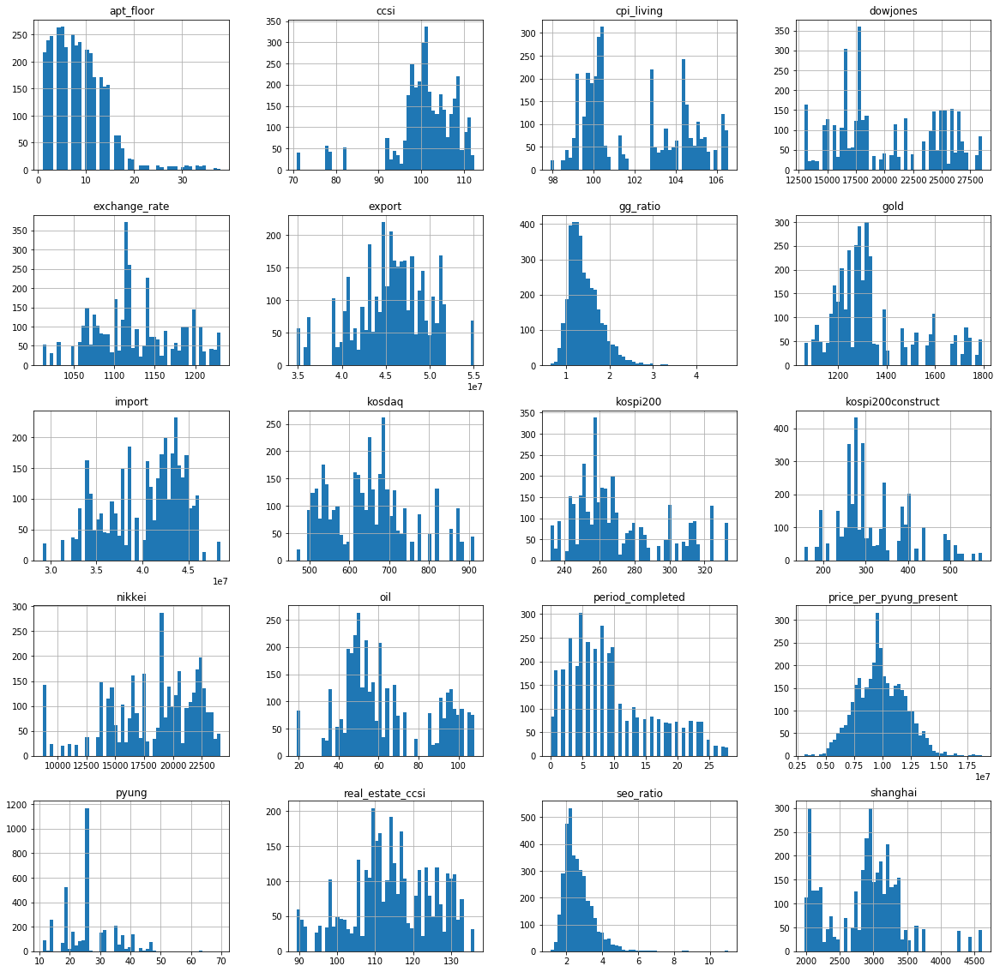

In [33]:
analysisD2.hist(bins=50, figsize=(20,20))
plt.show()
# pd.Series(np.log(analysisD["price_per_pyung_present"].values)).hist(bins=100)

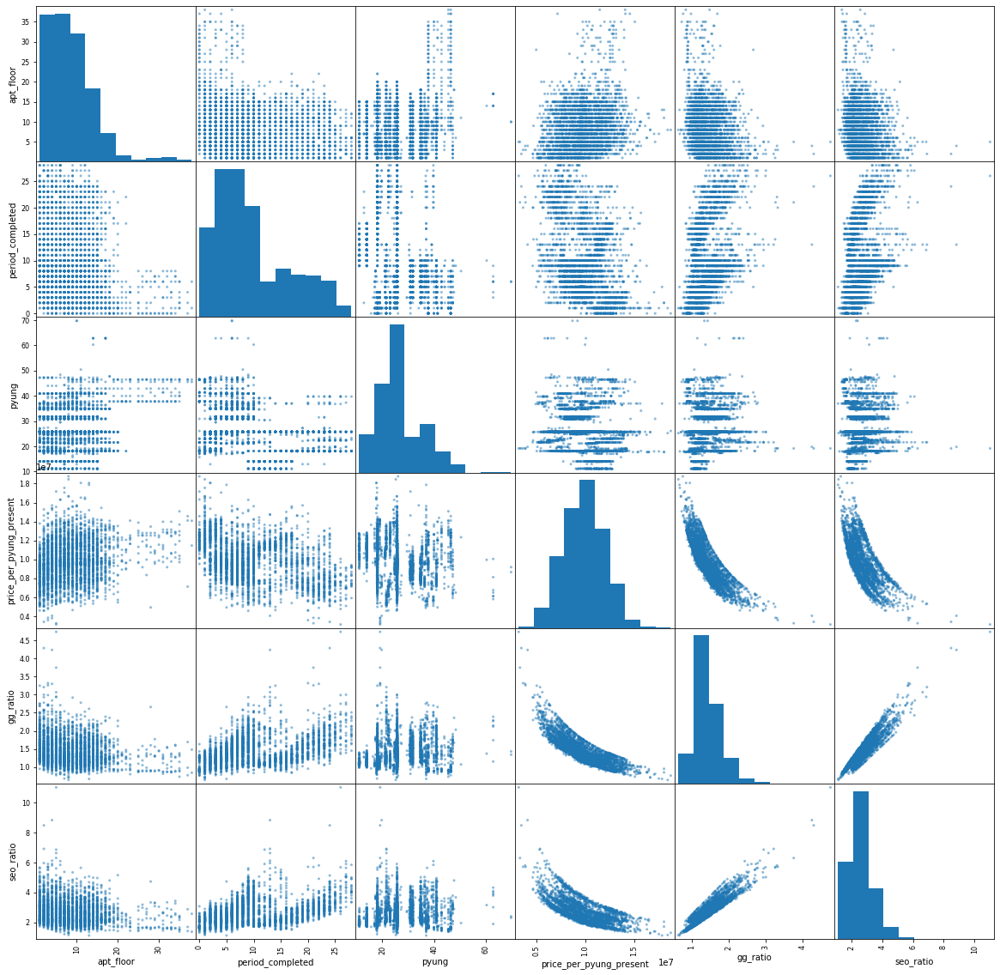

In [34]:
from pandas.plotting import scatter_matrix

attr = ["apt_floor", "period_completed", "pyung", "price_per_pyung_present", 'gg_ratio', 'seo_ratio']
scatter_matrix(analysisD2[attr], figsize=(20, 20))
plt.show()

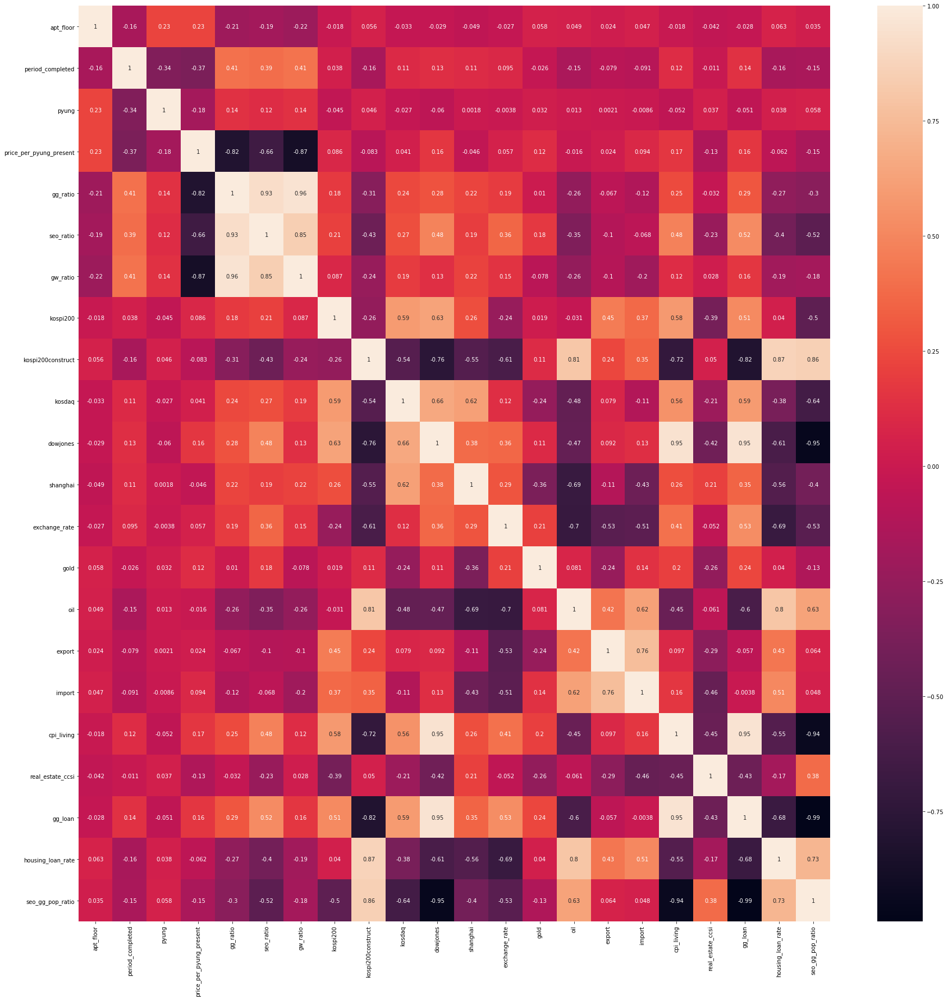

In [45]:
import seaborn as sns

plt.figure(figsize=(30,30))
sns.heatmap(corr_matrix2, annot=True)
plt.show()

In [48]:
# analysisD2.to_csv('sub-data-files/train_data_1.csv', index=False, encoding='utf-8-sig')

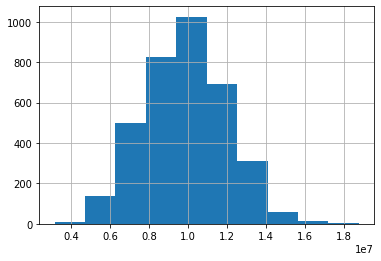

In [47]:
analysisD2['price_per_pyung_present'].hist()
plt.show()

In [49]:
analysisD2['price_per_pyung_present'].describe()

count    3.576000e+03
mean     9.832475e+06
std      2.121596e+06
min      3.133903e+06
25%      8.335162e+06
50%      9.697734e+06
75%      1.130676e+07
max      1.876856e+07
Name: price_per_pyung_present, dtype: float64

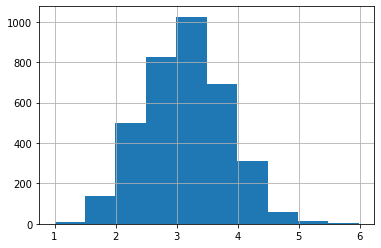

count    3576.000000
mean        3.137453
std         0.676982
min         1.000000
25%         2.659675
50%         3.094459
75%         3.607885
max         5.988876
Name: price_cat, dtype: float64


In [63]:
analysisD2['price_cat'] = analysisD2['price_per_pyung_present'] / 3.133903e+06
analysisD2['price_cat'].hist()
plt.show()

print(analysisD2['price_cat'].describe())

In [68]:
# count    3576.000000
# mean        3.137453
# std         0.676982
# min         1.000000
# 25%         2.659675
# 50%         3.094459
# 75%         3.607885
# max         5.988876
# Name: price_cat, dtype: float64

def calc_price_categorize(D):

    if D['price_cat'] < 2.659675 :
        D['price_cat'] = 1.0
    elif D['price_cat'] < 3.094459:
        D['price_cat'] = 2.0
    elif D['price_cat'] < 3.607885:
        D['price_cat'] = 3.0
    else:
        D['price_cat'] = 4.0

    return D
    
analysisD2 = analysisD2.apply(calc_price_categorize, axis=1)
analysisD2.info()
analysisD2.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3576 entries, 0 to 3575
Data columns (total 23 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   apt_floor                3576 non-null   float64
 1   period_completed         3576 non-null   float64
 2   pyung                    3576 non-null   float64
 3   price_per_pyung_present  3576 non-null   float64
 4   gg_ratio                 3576 non-null   float64
 5   seo_ratio                3576 non-null   float64
 6   gw_ratio                 3576 non-null   float64
 7   kospi200                 3576 non-null   float64
 8   kospi200construct        3576 non-null   float64
 9   kosdaq                   3576 non-null   float64
 10  dowjones                 3576 non-null   float64
 11  shanghai                 3576 non-null   float64
 12  exchange_rate            3576 non-null   float64
 13  gold                     3576 non-null   float64
 14  oil                     

,apt_floor,period_completed,pyung,price_per_pyung_present,gg_ratio,seo_ratio,gw_ratio,kospi200,kospi200construct,kosdaq,...,gold,oil,export,import,cpi_living,real_estate_ccsi,gg_loan,housing_loan_rate,seo_gg_pop_ratio,price_cat
0,5.0,9.0,14.00,10597928.0,1.00,1.84,0.52,250.08,533.66,467.61,...,1600.0,88.06,44667681.0,41976900.0,97.897,97.0,170013.8,4.64,0.85,3.0
1,10.0,9.0,14.00,10443214.0,1.01,1.87,0.53,250.08,533.66,467.61,...,1600.0,88.06,44667681.0,41976900.0,97.897,97.0,170013.8,4.64,0.85,3.0
2,7.0,2.0,34.82,8912198.0,1.19,2.19,0.62,250.08,533.66,467.61,...,1600.0,88.06,44667681.0,41976900.0,97.897,97.0,170013.8,4.64,0.85,2.0
3,11.0,20.0,37.28,5592844.0,1.89,3.50,0.99,250.08,533.66,467.61,...,1600.0,88.06,44667681.0,41976900.0,97.897,97.0,170013.8,4.64,0.85,1.0
4,1.0,20.0,22.31,4611170.0,2.30,4.24,1.20,250.08,533.66,467.61,...,1600.0,88.06,44667681.0,41976900.0,97.897,97.0,170013.8,4.64,0.85,1.0


In [69]:
# 가격 분포별 나누기 비율, 카테고리
analysisD2['price_cat'].value_counts()

4.0    894
1.0    894
2.0    894
3.0    894
Name: price_cat, dtype: int64